# Introduction

Our notebooks have been initialized thanks to several sources provided around the Home Credit default risk [Kaggle](https://www.kaggle.com/c/home-credit-default-risk) competition: data from Home Credit, Kernels-Notebooks from competitors, Discussions threads involving host and competitors.

While the objective of competitors is to get the best AUC score _Area under the ROC Curve_ by *__any means__*, we'll rather focuse on the ability to provide *__interpretable__* decisions, including the possibility given to customers to explore their case.

# Notebooks & dashboard

There are 4 different notebooks:
* __Current : P7_EDA__: focusing on Exploratory Data Analysis,
* __P7_FE_FS__: focusing on Feature engineering and a first model-agnostic Feature Selection,
* __P7_Model__: focusing on scoring with model evaluation,
* __P7_Interpretation__ : focusing on model interpretation,
And a dashboard python file.


# Data

This diagram shows data relationship :

<img src="https://storage.googleapis.com/kaggle-media/competitions/home-credit/home_credit.png" class="svg" alt="" width="700" height="700">

There are 7 different sources of data:
Current application:
* __application__: details about each `SK_ID_CURR` loan application and applicant + `TARGET` indicating the risk of failure to repay loan on time.
* __test__: where the `TARGET` has not been calculated yet.

External previous credits information:
* __bureau__: details about each `SK_ID_BUREAU` client's previous credits oustide our company, with cardinality 1:n from current application.
* __bureau_balance__: monthly details of each `SK_ID_BUREAU`.
Internal previous credit information:
* __previous_application__: details about each `SK_ID_PREV` client's previous credits applications within our company, with cardinality 1:n from current application.
* __POS_CASH_balance__: monthly details of each `SK_ID_PREV` (credits or cash types).
* __credit_card_balance__: monthly details of each `SK_ID_PREV` (credit cards revolving type).
* __installments_payment__: payment history of each `SK_ID_PREV`.

Moreover, we are provided with the features definitions (in `HomeCredit_columns_description.csv`). 

# Forewords

In this EDA notebook, we observe any valuable information in order to prepare next steps: Feature Engineering & aggregation process. The idea is to build and intermediate __fully understandable__ dataset, i.e. with any of its feature dealing with relevant details that could be discussed by counsellor in front of an applicant.<br/>
This means we'll have to avoid using "black box" features.
This will surely affect the ability to reach the amazing scores of Kaggle competitors, and it implies to spend additionnal time for the EDA and FE.<br/>
Furthermore, we have to consider this task according to the expectations of the study, which consists in performing __model optimization__ and __model interpretation__. <br/>
This will lead to consider as further optional tasks many EDA & FE ideas, in order to use __model__ and its __interpretation__ bring value in that perspective. <br/>

# Imports

In [1]:
# numpy and pandas for data manipulation
import numpy as np
import pandas as pd

In [2]:
# eda booster - turn off flake8 to avoid logs
from dataprep.eda import plot, plot_correlation, plot_missing

In [6]:
# File system manangement
import os
# pickle
import pickle

In [4]:
# matplotlib and seaborn for plotting
import matplotlib.pyplot as plt
import seaborn as sns

In [5]:
# custom functions
# visuals
from ipynb.fs.full.functions import plot_bar_gen, heatmap, kde_plot
# processing
from ipynb.fs.full.functions import one_hot_encoder, label_encoder, agg_numeric
# analysis
from ipynb.fs.full.functions import target_corrs, target_corrs_corr, missing_values_table, count_categorical
# df optimization
from ipynb.fs.full.functions import convert_types

In [6]:
# Suppress warnings
import warnings
warnings.filterwarnings('ignore')

In [7]:
# paramètres
# to display any columns
pd.options.display.max_columns = 122
sns.set(style="ticks")
sns.set_style('whitegrid')

## Read in Data 

First, we can list all the available data files. There are a total of 8 files: 2 main files for training (with target) & testing (without the target), and 6 other files containing additional information about each loan. <br/> 
We will analyze target according to training files, then we'll analyze applicant's profile and previous application knowledge. Additionnal features will be engineered for 'any_applications', then splitted back to train/test.

In [8]:
# List files available
print(os.listdir("Data/"))

['aggregated.csv', 'application_test.csv', 'application_train.csv', 'application_trunc.csv', 'backup_full_aggregated.csv', 'backup_opti_aggregated.csv', 'bureau.csv', 'bureau_balance.csv', 'credit_card_balance.csv', 'desc.pkl', 'Descriptions.xlsx', 'final.csv', 'full_aggregated.csv', 'HomeCredit_columns_description.csv', 'ID_any_app.csv', 'ID_bureau.csv', 'ID_card.csv', 'ID_credit.csv', 'ID_installments.csv', 'ID_previous.csv', 'installments_payments.csv', 'opti_aggregated.csv', 'POS_CASH_balance.csv', 'previous_application.csv', 'sample_submission.csv', '~$Descriptions.xlsx']


In [2]:
# first level
application = pd.read_csv('Data/application_train.csv')
test = pd.read_csv('Data/application_test.csv')

In [3]:
# target
target = application.filter(['SK_ID_CURR', 'TARGET'])

In [7]:
with open("Data/target.pkl", mode="wb") as df0:
    pickle.dump(target, df0)

In [8]:
del target

In [10]:
# create the entire SK_ID_CURR dataset : any_applications
any_applications = application.append(test).reset_index()
# remove previous index
any_applications.drop(columns=['index'], inplace=True)

In [11]:
# nb of applicants & features
print(application.shape)
print(any_applications.shape)

(307511, 122)
(356255, 122)


In [12]:
# second level
bureau = pd.read_csv('Data/bureau.csv')
print(bureau.shape)

(1716428, 17)


In [13]:
# second level
previous = pd.read_csv('Data/previous_application.csv')
print(previous.shape)

(1670214, 37)


In [91]:
# third level
credit_balance = pd.read_csv('Data/POS_CASH_balance.csv')
print(credit_balance.shape)

(10001358, 8)


In [92]:
# third level
card_balance = pd.read_csv('Data/credit_card_balance.csv')
print(card_balance.shape)

(3840312, 23)


In [93]:
# third level
bureau_balance = pd.read_csv('Data/bureau_balance.csv')
print(bureau_balance.shape)

(27299925, 3)


In [94]:
# third level
installments = pd.read_csv('Data/installments_payments.csv')
print(installments.shape)

(13605401, 8)


The training data has 307511 observations (each one a separate loan) and 122 features (variables) including the `TARGET` (the label we want to predict).

In [18]:
print(test.shape)
test.head(3)

(48744, 121)


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,Unaccompanied,Working,Higher education,Married,House / apartment,0.018850,-19241,-2329,-5170.0,-812,NaN,1,1,0,1,0,1,NaN,2.0,2,2,TUESDAY,18,0,0,0,0,0,0,Kindergarten,0.752614,0.789654,0.159520,0.066,0.059,0.9732,NaN,NaN,NaN,0.1379,0.125,NaN,NaN,NaN,0.0505,NaN,NaN,0.0672,0.0612,0.9732,NaN,NaN,NaN,0.1379,0.125,NaN,NaN,NaN,0.0526,NaN,NaN,0.0666,0.059,0.9732,NaN,NaN,NaN,0.1379,0.125,NaN,NaN,NaN,0.0514,NaN,NaN,NaN,block of flats,0.0392,"Stone, brick",No,0.0,0.0,0.0,0.0,-1740.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.035792,-18064,-4469,-9118.0,-1623,NaN,1,1,0,1,0,0,Low-skill Laborers,2.0,2,2,FRIDAY,9,0,0,0,0,0,0,Self-employed,0.564990,0.291656,0.432962,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,NaN,Working,Higher education,Married,House / apartment,0.019101,-20038,-4458,-2175.0,-3503,5.0,1,1,0,1,0,0,Drivers,2.0,2,2,MONDAY,14,0,0,0,0,0,0,Transport: type 3,NaN,0.699787,0.610991,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-856.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0


In [19]:
print('Test and Train split (test size in % of total):', 
      round(100 * test.shape[0] / (application.shape[0] + test.shape[0]), 2))

Test and Train split (test size in % of total): 13.68


Split train | test is approx 13.7%

In [20]:
# getting columns descriptions
col_desc = pd.read_csv('Data/HomeCredit_columns_description.csv', encoding= 'unicode_escape')
print('HomeCredit_columns_description: ', col_desc.shape)
col_desc.head()

HomeCredit_columns_description:  (219, 5)


,Unnamed: 0,Table,Row,Description,Special
0,1,application_{train|test}.csv,SK_ID_CURR,ID of loan in our sample,NaN
1,2,application_{train|test}.csv,TARGET,Target variable (1 - client with payment diffi...,NaN
2,5,application_{train|test}.csv,NAME_CONTRACT_TYPE,Identification if loan is cash or revolving,NaN
3,6,application_{train|test}.csv,CODE_GENDER,Gender of the client,NaN
4,7,application_{train|test}.csv,FLAG_OWN_CAR,Flag if the client owns a car,NaN


In [21]:
# get rid of columns & remove duplicates (keep first)
desc = col_desc.filter(['Row', 'Description'])

In [22]:
desc.drop_duplicates(keep='first', inplace=True)

In [23]:
desc.head(1)

,Row,Description
0,SK_ID_CURR,ID of loan in our sample


In [24]:
# get the target description
pd.options.display.max_colwidth = len(desc[desc['Row'] == 'TARGET']['Description'])
desc[desc['Row'] == 'TARGET']['Description']

1    Target variable (1 - client with payment difficulties: he/she had late payment more than X days on at least one of the first Y installments of the loan in our sample, 0 - all other cases)
Name: Description, dtype: object

In [25]:
# save the lean desc
with open("Data/desc.pkl", mode="wb") as df:
    pickle.dump(desc, df)

# Exploratory Data Analysis

## Distribution of the Target Column

Let's rely on the rule as defined : client with payment difficulties means he/she had late payment more than X days on at least one of the first Y installments of the loan in our sample. <br/>
Here, {X, Y} are black-box parameters and they could differ according to the contract types or any other parameters. <br/>
Let's assume that those {Xcash, Ycash} & {Xrevolving, Yrevolving} or even {Xtime, Ytime} values have been adjusted for some good reason, so that learning from known client's failures could help predict future failures, and prevent damages by simply refusing to grant the laon, regardless the financial cost of an effective failure or the benefits.

In [26]:
# failure rate
print('Global failure rate: ' + str(
    round(100 * application[application['TARGET'] == 1].shape[0]/application.shape[0], 2)) + ' %')

Global failure rate: 8.07 %


In [27]:
# differentiate failure rates
cols = ['TARGET', 'NAME_CONTRACT_TYPE']
mask_rev = (application['NAME_CONTRACT_TYPE'] == 'Revolving loans')
mask_cash = (application['NAME_CONTRACT_TYPE'] == 'Cash loans')
mask_revfail = (application['TARGET'] == 1) & (application['NAME_CONTRACT_TYPE'] == 'Revolving loans')
mask_cashfail = (application['TARGET'] == 1) & (application['NAME_CONTRACT_TYPE'] == 'Cash loans')
print('Cash loans failure rate: ' + str(
      round(100 * application[cols][mask_cashfail].shape[0] / application[cols][mask_cash].shape[0], 2)) + ' %')
print('Revolving loans failure rate: ' + str(
      round(100 * application[cols][mask_revfail].shape[0] / application[cols][mask_rev].shape[0], 2)) + ' %')

Cash loans failure rate: 8.35 %
Revolving loans failure rate: 5.48 %


In [28]:
# stats for target / contract_type cases
application_count = application.groupby(
    ['NAME_CONTRACT_TYPE', 'TARGET'],
    as_index=False).agg({'SK_ID_CURR': ['count']})
application_count.columns = ['NAME_CONTRACT_TYPE',
                           'TARGET',
                           'count']
application_count['TARGET'] = application_count['TARGET'].replace([0, 1], ['Payed', 'Failed'])
application_count['NAME_CONTRACT_TYPE'] = application_count['NAME_CONTRACT_TYPE'].replace(
    ['Cash loans', 'Revolving loans'],
    ['Cash', 'Revolving'])
application_count['case'] =  application_count['TARGET'] + '_' + application_count['NAME_CONTRACT_TYPE']
application_count

,NAME_CONTRACT_TYPE,TARGET,count,case
0,Cash,Payed,255011,Payed_Cash
1,Cash,Failed,23221,Failed_Cash
2,Revolving,Payed,27675,Payed_Revolving
3,Revolving,Failed,1604,Failed_Revolving


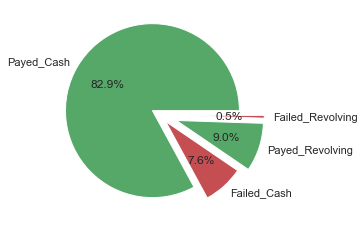

In [29]:
# failure by contract type
explodeList = (0.1, 0.1, 0.2, 0.2)
colorsList = ('g', 'r', 'g', 'r') 
plt.pie(application_count['count'],
        explode=explodeList,
        colors=colorsList,
        labels=application_count['case'],
        autopct='%1.1f%%')
plt.savefig("pie.png") 

## Contract types & Credits amounts

We check amounts & types from each of the 3 sources.

In [30]:
# case current application : loans amounts
plot(any_applications, "AMT_CREDIT", "NAME_CONTRACT_TYPE")

We'll deal later with outliers: application amount above a given threshold would surely require more attention by the company. <br/>
We can observe that Cash loans application involve higher amounts.

### Internal previous applications

In [31]:
# control SK_ID_PREV as a viable primary key
print(previous.shape[0] - len(previous['SK_ID_PREV'].unique()))

0


In [32]:
# case previous applications, loans amounts
plot(previous, "AMT_CREDIT", 'NAME_CONTRACT_TYPE')

Previous applications let appear the 3rd contract type 'consumer loans' with smaller GOODS_PRICE: we would consider those loans as a subpart of Cash loans.

In [33]:
print(previous[previous['NAME_CONTRACT_TYPE'] == 'XNA'].shape[0])
previous[previous['NAME_CONTRACT_TYPE'] == 'XNA'].sample(3)

346


,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
1325225,2186177,262999,XNA,NaN,0.0,0.0,NaN,NaN,THURSDAY,13,Y,1,NaN,NaN,NaN,XAP,Canceled,-353,XNA,XAP,NaN,Repeater,XNA,XNA,XNA,Country-wide,60,Connectivity,NaN,XNA,NaN,NaN,NaN,NaN,NaN,NaN,NaN
637230,2481106,209347,XNA,NaN,0.0,0.0,NaN,NaN,FRIDAY,9,Y,1,NaN,NaN,NaN,XAP,Canceled,-441,XNA,XAP,NaN,Repeater,XNA,XNA,XNA,Country-wide,30,Connectivity,NaN,XNA,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1547869,1018815,103715,XNA,NaN,0.0,0.0,NaN,NaN,THURSDAY,11,Y,1,NaN,NaN,NaN,XAP,Refused,-458,XNA,HC,NaN,Repeater,XNA,XNA,XNA,Country-wide,50,Connectivity,NaN,XNA,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [34]:
previous = previous[previous['NAME_CONTRACT_TYPE'] != 'XNA']

In [35]:
previous['N_CREDIT_TYPE'] = previous['NAME_CONTRACT_TYPE'].apply(lambda x: x if x == 'Revolving loans' else 'Cash loans')

In [36]:
print(previous[previous['FLAG_LAST_APPL_PER_CONTRACT'] != 'Y'].shape[0])
previous[previous['FLAG_LAST_APPL_PER_CONTRACT'] != 'Y'].sample(3)

8475


,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL,N_CREDIT_TYPE
292839,1958006,226180,Revolving loans,13500.0,180000.0,180000.0,NaN,180000.0,FRIDAY,12,N,0,NaN,NaN,NaN,XAP,Refused,-225,XNA,HC,Unaccompanied,Repeater,XNA,Cards,x-sell,Credit and cash offices,-1,XNA,0.0,XNA,Card X-Sell,NaN,NaN,NaN,NaN,NaN,NaN,Revolving loans
313937,2823487,446950,Revolving loans,4500.0,585000.0,585000.0,NaN,585000.0,SATURDAY,9,N,0,NaN,NaN,NaN,XAP,Refused,-219,XNA,HC,Unaccompanied,Repeater,XNA,Cards,x-sell,Credit and cash offices,0,XNA,0.0,XNA,Card X-Sell,NaN,NaN,NaN,NaN,NaN,NaN,Revolving loans
1200883,1808377,221903,Revolving loans,38250.0,765000.0,765000.0,NaN,765000.0,TUESDAY,3,N,1,NaN,NaN,NaN,XAP,Refused,-574,XNA,HC,NaN,Repeater,XNA,Cards,x-sell,Credit and cash offices,-1,XNA,0.0,XNA,Card X-Sell,NaN,NaN,NaN,NaN,NaN,NaN,Revolving loans


In [37]:
print(previous[previous['NFLAG_LAST_APPL_IN_DAY'] == 0].shape[0])
previous[previous['NFLAG_LAST_APPL_IN_DAY'] == 0].sample(3)

5900


,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL,N_CREDIT_TYPE
333775,2279406,397170,Revolving loans,9000.0,0.0,180000.0,NaN,NaN,THURSDAY,18,N,0,NaN,NaN,NaN,XAP,Refused,-2685,XNA,XNA,NaN,Repeater,XNA,Cards,x-sell,Country-wide,-1,Consumer electronics,0.0,XNA,Card Street,NaN,NaN,NaN,NaN,NaN,NaN,Revolving loans
13715,2122357,424490,Revolving loans,6750.0,0.0,180000.0,NaN,NaN,SATURDAY,11,N,0,NaN,NaN,NaN,XAP,Refused,-2362,XNA,LIMIT,NaN,Repeater,XNA,Cards,x-sell,Country-wide,30,Connectivity,0.0,XNA,Card X-Sell,NaN,NaN,NaN,NaN,NaN,NaN,Revolving loans
1460854,2125895,221828,Revolving loans,5625.0,45000.0,135000.0,NaN,45000.0,SUNDAY,15,N,0,NaN,NaN,NaN,XAP,Refused,-166,XNA,HC,Unaccompanied,Repeater,XNA,Cards,x-sell,Country-wide,79,Connectivity,0.0,XNA,Card X-Sell,NaN,NaN,NaN,NaN,NaN,NaN,Revolving loans


Although this could help to learn from cases where the applicant switched to alternate offers in order to reach an approval, this flags help to keep only the actual last status of an application.

In [38]:
previous = previous[previous['NFLAG_LAST_APPL_IN_DAY'] == 1]
previous = previous[previous['FLAG_LAST_APPL_PER_CONTRACT'] == 'Y']


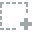
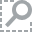
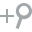
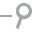
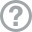
...
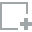
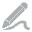
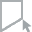
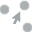
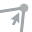

In [39]:
plot(previous, 'NAME_CONTRACT_STATUS')

In [40]:
print(previous[previous['NAME_CONTRACT_STATUS'] == 'Unused offer'].shape[0])
previous[previous['NAME_CONTRACT_STATUS'] == 'Unused offer'].sample(3)

26423


,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL,N_CREDIT_TYPE
1613257,1379014,157391,Consumer loans,NaN,128070.0,128070.0,0.0,128070.0,TUESDAY,17,Y,1,0.0,NaN,NaN,XAP,Unused offer,-539,Cash through the bank,CLIENT,NaN,Repeater,Mobile,XNA,XNA,Country-wide,25,Connectivity,NaN,XNA,POS mobile with interest,NaN,NaN,NaN,NaN,NaN,NaN,Cash loans
1419951,1970864,376903,Consumer loans,NaN,30996.0,30996.0,0.0,30996.0,TUESDAY,11,Y,1,0.0,NaN,NaN,XAP,Unused offer,-262,Cash through the bank,CLIENT,NaN,Repeater,Mobile,XNA,XNA,Country-wide,5,Connectivity,NaN,XNA,POS mobile with interest,NaN,NaN,NaN,NaN,NaN,NaN,Cash loans
787033,2143486,397012,Consumer loans,NaN,57595.5,57595.5,0.0,57595.5,WEDNESDAY,18,Y,1,0.0,NaN,NaN,XAP,Unused offer,-673,Cash through the bank,CLIENT,NaN,Repeater,Mobile,XNA,XNA,Country-wide,84,Connectivity,NaN,XNA,POS mobile with interest,NaN,NaN,NaN,NaN,NaN,NaN,Cash loans


In [41]:
previous = previous[previous['NAME_CONTRACT_STATUS'] != 'Canceled']

In [42]:
previous['N_FLAG_REJECTED'] = previous['NAME_CONTRACT_STATUS'].apply(lambda x: 1 if x == 'Refused' else 0)


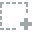
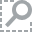
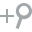
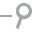
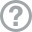
...
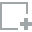
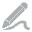
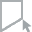
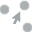
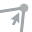

In [43]:
plot(previous, 'N_FLAG_REJECTED')


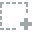
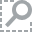
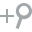
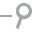
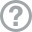
...
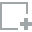
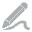
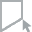
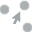
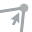

In [44]:
plot(previous, 'CODE_REJECT_REASON')

In [45]:
previous['CODE_REJECT_REASON'] = 'REJECTED_' + previous['CODE_REJECT_REASON'].astype(str)

In [46]:
previous['N_CONTRACT_STATUS'] = previous['CODE_REJECT_REASON'].apply(lambda x: x if x != 'REJECTED_XAP' else 'APPROVED')


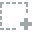
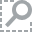
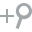
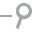
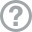
...
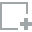
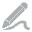
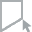
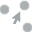
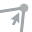

In [47]:
plot(previous, 'N_CONTRACT_STATUS')

In [48]:
sample = previous[previous['DAYS_FIRST_DUE'].isna()]
print(sample[sample['N_CONTRACT_STATUS'] == 'APPROVED'].shape[0])
sample[sample['N_CONTRACT_STATUS'] == 'APPROVED'].sample(3)

39604


,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL,N_CREDIT_TYPE,N_FLAG_REJECTED,N_CONTRACT_STATUS
1061562,2774113,139339,Cash loans,16346.25,135000.0,152820.0,NaN,135000.0,WEDNESDAY,9,Y,1,NaN,NaN,NaN,Wedding / gift / holiday,Approved,-168,Cash through the bank,REJECTED_XAP,Unaccompanied,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,12.0,middle,Cash Street: middle,NaN,NaN,NaN,NaN,NaN,NaN,Cash loans,0,APPROVED
1257166,2027586,241227,Consumer loans,6636.69,131652.0,146538.0,0.0,131652.0,WEDNESDAY,11,Y,1,0.0,NaN,NaN,XAP,Approved,-990,Cash through the bank,REJECTED_XAP,Unaccompanied,Repeater,Computers,POS,XNA,Country-wide,3000,Consumer electronics,24.0,low_action,POS household without interest,NaN,NaN,NaN,NaN,NaN,NaN,Cash loans,0,APPROVED
984841,2503008,421060,Revolving loans,6750.00,135000.0,135000.0,NaN,135000.0,WEDNESDAY,16,Y,1,NaN,NaN,NaN,XAP,Approved,-171,XNA,REJECTED_XAP,Unaccompanied,Repeater,XNA,Cards,x-sell,Credit and cash offices,-1,XNA,0.0,XNA,Card X-Sell,NaN,NaN,NaN,NaN,NaN,NaN,Revolving loans,0,APPROVED


In [49]:
previous.loc[(previous['NAME_CONTRACT_STATUS'] == 'Approved') & (previous['DAYS_FIRST_DUE'].isna()), 'N_CONTRACT_STATUS'] = 'NOTUSED'


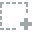
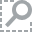
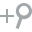
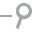
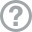
...
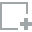
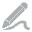
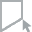
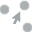
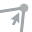

In [50]:
plot(previous, 'N_CONTRACT_STATUS')

In [51]:
previous_status_count = previous.groupby(['SK_ID_CURR', 'N_CONTRACT_STATUS']).size().unstack(fill_value=0)

In [52]:
previous_status_count.head(3)

N_CONTRACT_STATUS,APPROVED,NOTUSED,REJECTED_CLIENT,REJECTED_HC,REJECTED_LIMIT,REJECTED_SCO,REJECTED_SCOFR,REJECTED_SYSTEM,REJECTED_VERIF,REJECTED_XNA
SK_ID_CURR,,,,,,,,,,
100001,1,0,0,0,0,0,0,0,0,0
100002,1,0,0,0,0,0,0,0,0,0
100003,3,0,0,0,0,0,0,0,0,0


In [53]:
previous_status_count.columns = ['N_CNT_PREV_' + str(col) for col in previous_status_count.columns]

In [54]:
any_applications = any_applications.merge(previous_status_count, on='SK_ID_CURR', how='left')

In [55]:
for i in previous_status_count.columns:
    any_applications[i] = any_applications[i].fillna(0)

In [56]:
any_applications.head(1)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,...,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,N_CNT_PREV_APPROVED,N_CNT_PREV_NOTUSED,N_CNT_PREV_REJECTED_CLIENT,N_CNT_PREV_REJECTED_HC,N_CNT_PREV_REJECTED_LIMIT,N_CNT_PREV_REJECTED_SCO,N_CNT_PREV_REJECTED_SCOFR,N_CNT_PREV_REJECTED_SYSTEM,N_CNT_PREV_REJECTED_VERIF,N_CNT_PREV_REJECTED_XNA
0,100002,1.0,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.0,0.069,0.0833,0.125,0.0369,0.0202,0.019,0.0,0.0,0.0252,0.0383,0.9722,...,0.0,0.025,0.0369,0.9722,0.6243,0.0144,0.0,0.069,0.0833,0.125,0.0375,0.0205,0.0193,0.0,0.0,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [57]:
# get most recent rejection
previous_last_loan_rejection = previous.groupby(
    ['SK_ID_CURR', 'N_FLAG_REJECTED'],
    as_index=False).agg(
    {'DAYS_DECISION': ['max']})
previous_last_loan_rejection.columns = [
    'SK_ID_CURR',
    'N_FLAG_REJECTED',
    'N_PREV_LAST_REJECTION']
previous_last_loan_rejection = previous_last_loan_rejection.sort_values(
    by='N_PREV_LAST_REJECTION',
    ascending=False)
#  keep last rejection only
previous_last_loan_rejection = previous_last_loan_rejection.drop_duplicates(
    subset='SK_ID_CURR',
    keep='first')
# compute the last rejection recency index
previous_last_loan_rejection['N_ADJ_REJECT_INDEX'] = (
    1 - (previous_last_loan_rejection['N_PREV_LAST_REJECTION'] / - 2922)) * previous_last_loan_rejection['N_FLAG_REJECTED']

In [58]:
previous_last_loan_rejection.head(3)

,SK_ID_CURR,N_FLAG_REJECTED,N_PREV_LAST_REJECTION,N_ADJ_REJECT_INDEX
343851,369722,0,-1,0.0
441910,446450,0,-1,0.0
137605,207976,0,-2,0.0


In [59]:
any_applications = any_applications.merge(previous_last_loan_rejection, on='SK_ID_CURR', how='left')

In [60]:
any_applications['N_ADJ_REJECT_INDEX'] = any_applications['N_ADJ_REJECT_INDEX'].fillna(0)
any_applications['N_PREV_LAST_REJECTION'] = any_applications['N_PREV_LAST_REJECTION'].fillna(-2922)
any_applications['N_FLAG_REJECTED'] = any_applications['N_FLAG_REJECTED'].fillna(0)

In [61]:
# get most recent internal laon by decision
previous_last_loan_decision = previous.groupby(
    ['SK_ID_CURR', 'N_CONTRACT_STATUS'],
    as_index=False).agg(
    {'DAYS_DECISION': ['max']})
previous_last_loan_decision.columns = [
    'SK_ID_CURR',
    'N_CONTRACT_STATUS',
    'N_PREV_LAST_APPLICATION']
previous_last_loan_decision = previous_last_loan_decision.sort_values(
    by='N_PREV_LAST_APPLICATION',
    ascending=False)

In [62]:
#  keep last decision only
previous_last_loan_decision = previous_last_loan_decision.drop_duplicates(
    subset='SK_ID_CURR',
    keep='first')
# rename the new feature
previous_last_loan_decision = previous_last_loan_decision.rename(columns={'N_CONTRACT_STATUS': 'N_PREV_LAST_DECISION'})

In [63]:
previous_last_loan_decision.head(3)

,SK_ID_CURR,N_PREV_LAST_DECISION,N_PREV_LAST_APPLICATION
410988,369722,APPROVED,-1
528211,446450,APPROVED,-1
45206,129617,REJECTED_HC,-2


In [64]:
previous_last_loan_decision[previous_last_loan_decision['SK_ID_CURR'] == 456255]

,SK_ID_CURR,N_PREV_LAST_DECISION,N_PREV_LAST_APPLICATION
543161,456255,REJECTED_HC,-171


In [65]:
any_applications = any_applications.merge(previous_last_loan_decision, on='SK_ID_CURR', how='left')

In [66]:
any_applications['N_PREV_LAST_DECISION'].unique()

array(['APPROVED', 'REJECTED_LIMIT', nan, 'REJECTED_HC', 'NOTUSED',
       'REJECTED_SCOFR', 'REJECTED_CLIENT', 'REJECTED_SCO',
       'REJECTED_XNA', 'REJECTED_VERIF', 'REJECTED_SYSTEM'], dtype=object)

In [67]:
any_applications['N_PREV_LAST_DECISION'] = any_applications['N_PREV_LAST_DECISION'].fillna('NONE')
any_applications['N_PREV_LAST_APPLICATION'] = any_applications['N_PREV_LAST_APPLICATION'].fillna(-2922)


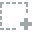
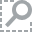
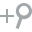
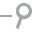
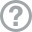
...
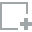
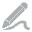
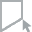
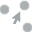
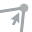

In [68]:
# get previous internal loans count
previous_loan_counts = previous.groupby(
    'SK_ID_CURR',
    as_index=False)['SK_ID_PREV'].count().rename(columns={'SK_ID_PREV': 'N_CNT_PREV_LOANS'})
any_applications = any_applications.merge(previous_loan_counts, on='SK_ID_CURR', how='left')
plot(any_applications, 'N_CNT_PREV_LOANS')

5 % of applicants have no previous internal loan info. Average of known previous applications is 4 and goes up to 74 previous applications for one single applicant.

In [69]:
any_applications.head(2)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,...,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,N_CNT_PREV_APPROVED,N_CNT_PREV_NOTUSED,N_CNT_PREV_REJECTED_CLIENT,N_CNT_PREV_REJECTED_HC,N_CNT_PREV_REJECTED_LIMIT,N_CNT_PREV_REJECTED_SCO,N_CNT_PREV_REJECTED_SCOFR,N_CNT_PREV_REJECTED_SYSTEM,N_CNT_PREV_REJECTED_VERIF,N_CNT_PREV_REJECTED_XNA,N_FLAG_REJECTED,N_PREV_LAST_REJECTION,N_ADJ_REJECT_INDEX,N_PREV_LAST_DECISION,N_PREV_LAST_APPLICATION,N_CNT_PREV_LOANS
0,100002,1.0,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,...,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-606.0,0.0,APPROVED,-606.0,1.0
1,100003,0.0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,...,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.01,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-746.0,0.0,APPROVED,-746.0,3.0


In [70]:
any_applications['N_REJECT_RATE'] = 1 - (
    any_applications['N_CNT_PREV_APPROVED'] + any_applications['N_CNT_PREV_NOTUSED']) / any_applications['N_CNT_PREV_LOANS']

In [129]:
any_applications['N_REJECT_RATE'] = any_applications['N_REJECT_RATE'].fillna(0)


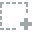
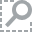
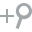
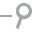
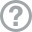
...
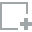
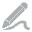
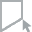
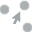
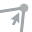

In [71]:
plot(any_applications['N_REJECT_RATE'])

### External loans


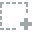
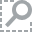
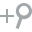
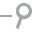
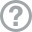
...
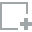
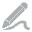
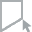
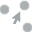
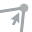

In [72]:
# case of external loans from "Credit Bureau"
plot(bureau, 'CREDIT_TYPE')

The largest value (Consumer credit) is over 3 times larger than the second largest value (Credit card)

Bureau applications let appear many other contract types, mainly due to the detailed purpose & context of the application. We should merge first to dig deeper, then eventually grouping relevant new types into application subset : basically we would consider only Credit Card as Revolving credits, and others as Cash + Consumer credits.

In [73]:
# clip by Mortgage upper whisker for line chart view
plot(bureau[bureau['AMT_CREDIT_SUM'] < 2500000], "AMT_CREDIT_SUM", 'CREDIT_TYPE')

In [74]:
bureau['CREDIT_TYPE'] = bureau['CREDIT_TYPE'].apply(lambda x: x if x == 'Credit card' else 'Cash loans')


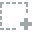
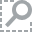
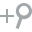
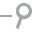
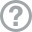
...
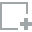
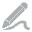
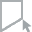
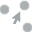
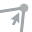

In [75]:
# get previous external loans count
bureau_loan_counts = bureau.groupby(
    'SK_ID_CURR',
    as_index=False)['SK_ID_BUREAU'].count().rename(columns={'SK_ID_BUREAU': 'N_CNT_BUR_LOANS'})
any_applications = any_applications.merge(bureau_loan_counts, on='SK_ID_CURR', how='left')
plot(any_applications, 'N_CNT_BUR_LOANS')

In [76]:
# get most recent external laon - approved only
bureau_last_loan_application = bureau.groupby(
    ['SK_ID_CURR'],
    as_index=False).agg(
    {'DAYS_CREDIT': ['max']})
bureau_last_loan_application.columns = [
    'SK_ID_CURR',
    'N_BUR_LAST_APPLICATION']
bureau_last_loan_application = bureau_last_loan_application.sort_values(
    by='N_BUR_LAST_APPLICATION',
    ascending=False)

In [77]:
bureau_last_loan_application

,SK_ID_CURR,N_BUR_LAST_APPLICATION
229613,367465,0
71154,182735,0
148948,273313,0
248926,390003,0
225873,363106,0
...,...,...
217097,352888,-2922
45398,152867,-2922
64514,175053,-2922
251327,392779,-2922


In [78]:
any_applications = any_applications.merge(bureau_last_loan_application, on='SK_ID_CURR', how='left')

In [79]:
any_applications['N_BUR_LAST_APPLICATION'] = any_applications['N_BUR_LAST_APPLICATION'].fillna(-2922)

In [80]:
# get the total count of loans
any_applications['N_CNT_BUR_LOANS'] = any_applications['N_CNT_BUR_LOANS'].fillna(0)
any_applications['N_CNT_PREV_LOANS'] = any_applications['N_CNT_PREV_LOANS'].fillna(0)
any_applications['N_CNT_TOT_LOANS'] = any_applications['N_CNT_BUR_LOANS'] + any_applications['N_CNT_PREV_LOANS']


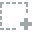
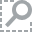
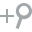
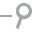
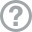
...
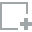
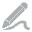
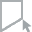
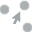
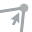

In [81]:
plot(any_applications['N_CNT_TOT_LOANS'])

In [82]:
print('Clients with previous external loans: ' + str(
    round(100 - 100 * any_applications[any_applications['N_CNT_BUR_LOANS'] == 0].shape[0]/any_applications.shape[0], 2)) + ' %')
print('Clients with previous internal loans: ' + str(
    round(100 - 100 * any_applications[any_applications['N_CNT_PREV_LOANS'] == 0].shape[0]/any_applications.shape[0], 2)) + ' %')
print('Clients with no previous loans: ' + str(
    round(100 * any_applications[any_applications['N_CNT_TOT_LOANS'] == 0].shape[0]/any_applications.shape[0], 2)) + ' %')

Clients with previous external loans: 85.84 %
Clients with previous internal loans: 95.03 %
Clients with no previous loans: 0.76 %


In [83]:
with_both = any_applications[(any_applications['N_CNT_PREV_LOANS'] > 0) & (any_applications['N_CNT_BUR_LOANS'] > 0)].shape[0]
print('Clients with both loans knowledge: ' + str(
    round(100 * with_both/any_applications.shape[0], 2)) + ' %')

Clients with both loans knowledge: 81.63 %


In [84]:
test = test.merge(previous_loan_counts, on='SK_ID_CURR', how='left')
test = test.merge(bureau_loan_counts, on='SK_ID_CURR', how='left')
test['N_CNT_BUR_LOANS'] = test['N_CNT_BUR_LOANS'].fillna(0)
test['N_CNT_PREV_LOANS'] = test['N_CNT_PREV_LOANS'].fillna(0)
test['N_CNT_TOT_LOANS'] = test['N_CNT_BUR_LOANS'] + test['N_CNT_PREV_LOANS']

In [85]:
application = application.merge(previous_loan_counts, on='SK_ID_CURR', how='left')
application = application.merge(bureau_loan_counts, on='SK_ID_CURR', how='left')
application['N_CNT_BUR_LOANS'] = application['N_CNT_BUR_LOANS'].fillna(0)
application['N_CNT_PREV_LOANS'] = application['N_CNT_PREV_LOANS'].fillna(0)
application['N_CNT_TOT_LOANS'] = application['N_CNT_BUR_LOANS'] + application['N_CNT_PREV_LOANS']

In [86]:
print(test[test['N_CNT_TOT_LOANS'] == 0].shape[0])
print(application[application['N_CNT_TOT_LOANS'] == 0].shape[0])

213
2502


In [87]:
print('rate of unknown applicants, test set: ' + str(
      round(100 * test[test['N_CNT_TOT_LOANS'] == 0].shape[0] / test.shape[0], 2)) + ' %')

rate of unknown applicants, test set: 0.44 %


In [88]:
print('rate of unknown applicants, train set: ' + str(
      round(100 * application[application['N_CNT_TOT_LOANS'] == 0].shape[0] / application.shape[0], 2)) + ' %')

rate of unknown applicants, train set: 0.81 %


## Monthly balance

We dig one level deeper with x_balance datasets, containing monthly balances of any credit.

In [89]:
sk_prev_ids = previous['SK_ID_PREV'].unique()
print('number of previous applications: ' + str(len(sk_prev_ids)))

number of previous applications: 1344605


In [95]:
# how many previous loans have their installments details & of previous
ins_sk_prev_ids = installments['SK_ID_PREV'].unique()
print('number of previous applications with installments details: ' + str(len(ins_sk_prev_ids)))
print('rate of previous applications with installments details: ')
print(round(len(set(ins_sk_prev_ids).intersection(set(sk_prev_ids)))/len(sk_prev_ids), 2))
print('excess rate of installments details - without previous applications to refer to: ')
print(round((len(ins_sk_prev_ids) - len(set(ins_sk_prev_ids).intersection(set(sk_prev_ids))))/len(ins_sk_prev_ids), 2))

number of previous applications with installments details: 997752
rate of previous applications with installments details: 
0.71
excess rate of installments details - without previous applications to refer to: 
0.04


29% of previous applications have no installements (for many reasons such as revolving not yet active, rejected loans, etc.) and 4% of installements details are not linked to a previous application.

In [96]:
# how many previous loans have their credit balance details & of previous
credit_sk_prev_ids = credit_balance['SK_ID_PREV'].unique()
print('number of previous applications with credit balance details: ' + str(len(credit_sk_prev_ids)))
print('rate of previous applications with credit balance details: ')
print(round(len(set(credit_sk_prev_ids).intersection(set(sk_prev_ids)))/len(sk_prev_ids), 2))
print('excess rate of credit balance details - without previous applications to refer to: ')
print(round((len(credit_sk_prev_ids) - len(set(credit_sk_prev_ids).intersection(set(sk_prev_ids))))/len(credit_sk_prev_ids), 2))

number of previous applications with credit balance details: 936325
rate of previous applications with credit balance details: 
0.67
excess rate of credit balance details - without previous applications to refer to: 
0.04


33% of previous applications have no credits balance (for many reasons such as alternate type of contract, etc.) and 4% of credit balance are not linked to a previous application.

In [97]:
# how many previous loans have their card balance details & of previous
card_sk_prev_ids = card_balance['SK_ID_PREV'].unique()
print('number of previous applications with card balance details: ' + str(len(card_sk_prev_ids)))
print('rate of previous applications with card balance details: ')
print(round(len(set(card_sk_prev_ids).intersection(set(sk_prev_ids)))/len(sk_prev_ids), 2))
print('excess rate of card balance details - without previous applications to refer to: ')
print(round((len(card_sk_prev_ids) - len(set(card_sk_prev_ids).intersection(set(sk_prev_ids))))/len(card_sk_prev_ids), 2))

number of previous applications with card balance details: 104307
rate of previous applications with card balance details: 
0.07
excess rate of card balance details - without previous applications to refer to: 
0.11


93% of previous applications have no card balance (for many reasons such as alternate type of contract), and 11% of card balance are not linked to a previous application.

! there are numerous installments, credit or card balance details of previous credit not in the df previous, and there are numerous previous applications without balance details.

In [98]:
# check if no common sk_id between credit and card balance
common_sk_prev_ids = list(set(credit_sk_prev_ids).intersection(set(card_sk_prev_ids)))
len(common_sk_prev_ids)

0

In [99]:
# how many previous loans doesnt't have card nor credit details
a = len(set(card_sk_prev_ids).intersection(set(sk_prev_ids)))
b = len(set(credit_sk_prev_ids).intersection(set(sk_prev_ids)))
print('rate of previous application with no balance details  : ' + str(
    round(100 * (len(sk_prev_ids) - (a + b))/len(sk_prev_ids), 2)) + ' %')

rate of previous application with no balance details  : 26.29 %


In [100]:
# how many credits balances have installments details, of overall
ins_cred_sk_prev_ids = list(set(ins_sk_prev_ids).intersection(set(credit_sk_prev_ids)))
print(len(ins_cred_sk_prev_ids))
print(len(credit_sk_prev_ids) - len(ins_cred_sk_prev_ids))

924949
11376


In [101]:
# how many card balances have installments details, of overall
ins_card_sk_prev_ids = list(set(ins_sk_prev_ids).intersection(set(card_sk_prev_ids)))
print(len(ins_card_sk_prev_ids))
print(len(card_sk_prev_ids) - len(ins_card_sk_prev_ids))

72466
31841


There is an inconsistency between the previous loans level of detail and the 3 sub-level sources of detail : therefore, to keep any valuable information from any of the 4 files, we'll have to find a way to skip the merge with previous loans and rather gather on SK_ID_CURR. 


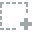
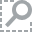
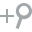
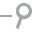
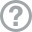
...
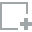
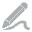
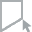
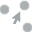
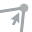

In [102]:
# monthly balance of the Bureau Credits
plot(bureau_balance['STATUS'], progress=False)

Basically we get here to the complete story of external loans (well, considering X - unknow info for 21,28% of months balance) : <br/>
- C status measures the credit closing AGE in months (DAYS_ENDDATE_FACT in bureau), and any others gives the TERM,
- STATUS from 1-30 days (1) to over 120 days (5) provide the knowledge of clients failure and how deep considering the value of STATUS,
- Failure in early installments could be somehow accessible : the minimal month number where occurs a failure, i.e. with STATUS in [1, 5].


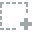
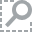
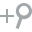
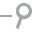
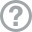
...
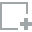
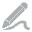
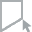
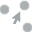
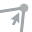

In [103]:
# same with credit balance
plot(credit_balance['NAME_CONTRACT_STATUS'], progress=False)

Opposite to Bureau credits, those contracts are mainly in an Active STATUS (not 'Completed' : closed), 'previous' will provide the right value.


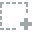
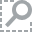
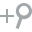
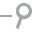
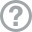
...
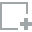
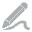
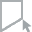
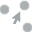
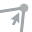

In [104]:
plot(credit_balance[credit_balance['CNT_INSTALMENT_FUTURE'] == 0], 'NAME_CONTRACT_STATUS')

In [105]:
focus_credit = credit_balance[credit_balance['CNT_INSTALMENT_FUTURE'] == 0]
focus_credit = focus_credit[focus_credit['NAME_CONTRACT_STATUS'] == 'Active']

In [106]:
focus_credit.sample(3)

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
7008128,1896041,248878,-62,12.0,0.0,Active,0,0
7425230,1891395,438443,-85,12.0,0.0,Active,0,0
4068016,2583305,250613,-69,8.0,0.0,Active,0,0


We got here the case of contracts still Active while there is no future installment : here closed by full payment before term. Let's see how 'previous' application table deal with it.

Contracts could remain in Active STATUS while actualy Completed by anticipation.

In [107]:
# Credit and Card balance
print('failure ratio : ' + str(
    credit_balance[credit_balance['SK_DPD_DEF'] > 0].shape[0] / credit_balance.shape[0]))
credit_balance[credit_balance['SK_DPD_DEF'] > 0].sample(3)

failure ratio : 0.011395352511128989


,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
6797456,1815713,147625,-70,10.0,0.0,Active,3,3
3955546,1100098,307139,-57,12.0,11.0,Active,18,18
2474226,1251276,213902,-67,12.0,8.0,Active,10,10


SK_DPD & SK_DPD_DEF contains over 1,1% of monthly failure - with DPD in days and a "tolerance" is applied to build SK_DPD_DEF, in case of small amounts.


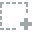
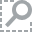
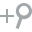
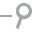
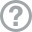
...
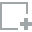
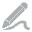
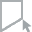
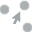
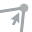

In [108]:
# same with card balance
plot(card_balance, 'NAME_CONTRACT_STATUS')

Again we observe an abnormal Active STATUS.

We won't ge deeper in that path, because we would rather get a similar info from both types of credits, and it represents too much additionnal effort to master this special credit card behavior.

# Client's profile depending on Target

We study the native features and their depency to target.

In [109]:
application.head(1)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,...,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,N_CNT_PREV_LOANS,N_CNT_BUR_LOANS,N_CNT_TOT_LOANS
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.0,0.069,0.0833,0.125,0.0369,0.0202,0.019,0.0,0.0,0.0252,0.0383,0.9722,...,0.069,0.0833,0.125,0.0377,0.022,0.0198,0.0,0.0,0.025,0.0369,0.9722,0.6243,0.0144,0.0,0.069,0.0833,0.125,0.0375,0.0205,0.0193,0.0,0.0,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,8.0,9.0



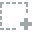
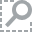
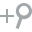
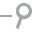
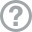
...
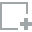
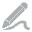
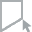
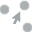
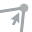

In [110]:
plot_missing(application)

In [111]:
any_applications = any_applications[any_applications['CODE_GENDER'] != 'XNA']
any_applications['YEARS_BIRTH'] = - any_applications['DAYS_BIRTH'] / 365
any_applications['OCCUPATION_TYPE'] = any_applications['OCCUPATION_TYPE'].fillna(any_applications['NAME_INCOME_TYPE'])
application = application[application['CODE_GENDER'] != 'XNA']
application['YEARS_BIRTH'] = - application['DAYS_BIRTH'] / 365
application['OCCUPATION_TYPE'] = application['OCCUPATION_TYPE'].fillna(application['NAME_INCOME_TYPE'])

In [112]:
# NaN values for DAYS_EMPLOYED: 365.243 -> nan
application['DAYS_EMPLOYED'].replace(365243, np.nan, inplace= True)
# Some simple new features (percentages)
application['N_DAYS_EMPLOYED_RATIO'] = application['DAYS_EMPLOYED'] / application['DAYS_BIRTH']
application['N_CREDIT_INCOME_RATIO'] = application['AMT_CREDIT'] / application['AMT_INCOME_TOTAL']
application['N_INCOME_PER_PERSON'] = application['AMT_INCOME_TOTAL'] / application['CNT_FAM_MEMBERS']
application['N_ANNUITY_INCOME_RATIO'] = application['AMT_ANNUITY'] / application['AMT_INCOME_TOTAL']
application['N_CREDIT_TERM'] = application['AMT_ANNUITY'] / application['AMT_CREDIT']
application.drop(columns=['DAYS_BIRTH'], inplace=True)

In [113]:
# NaN values for DAYS_EMPLOYED: 365.243 -> nan
any_applications['DAYS_EMPLOYED'].replace(365243, np.nan, inplace= True)
# Some simple new features (percentages)
any_applications['N_DAYS_EMPLOYED_RATIO'] = any_applications['DAYS_EMPLOYED'] / any_applications['DAYS_BIRTH']
any_applications['N_CREDIT_INCOME_RATIO'] = any_applications['AMT_CREDIT'] / any_applications['AMT_INCOME_TOTAL']
any_applications['N_INCOME_PER_PERSON'] = any_applications['AMT_INCOME_TOTAL'] / any_applications['CNT_FAM_MEMBERS']
any_applications['N_ANNUITY_INCOME_RATIO'] = any_applications['AMT_ANNUITY'] / any_applications['AMT_INCOME_TOTAL']
any_applications['N_CREDIT_TERM'] = any_applications['AMT_ANNUITY'] / any_applications['AMT_CREDIT']
any_applications.drop(columns=['DAYS_BIRTH'], inplace=True)

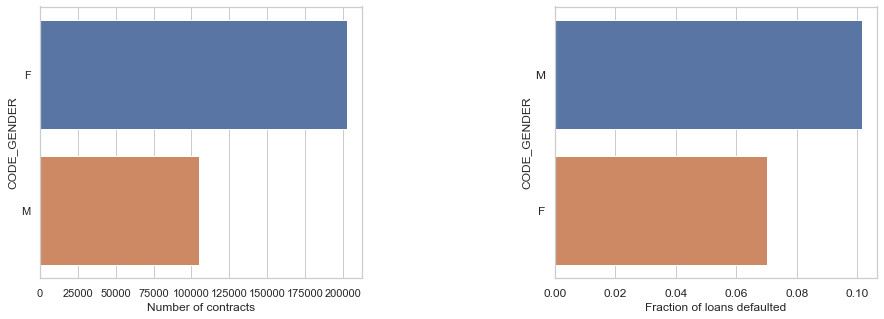

In [114]:
plot_bar_gen('CODE_GENDER', df=application)

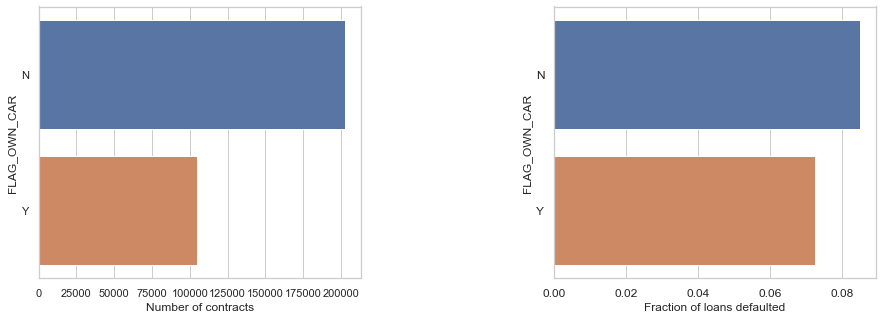

In [115]:
plot_bar_gen('FLAG_OWN_CAR', df=application)

In [116]:
application['OWN_CAR_AGE'].median()

9.0

In [117]:
application['OWN_CAR_AGE_LVL'] = pd.qcut(
    application['OWN_CAR_AGE'],
    3,
    labels=['RECENT_CAR',
            'AVG_AGE_CAR',
            'OLD_CAR'])

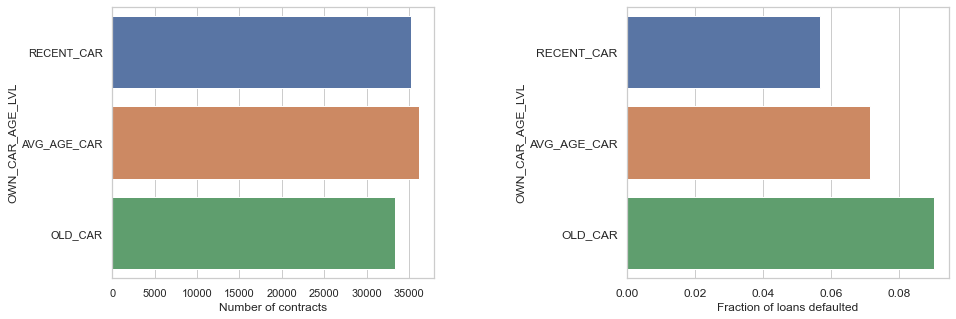

In [118]:
plot_bar_gen('OWN_CAR_AGE_LVL', df=application)

In [119]:
application['CNT_CHILDREN']
# bin child number
bins = [0, 5, np.inf]
values = ['0', '1']
application['CNT_CHILDREN_LVL'] = pd.cut(application['CNT_CHILDREN'], bins, labels=values)

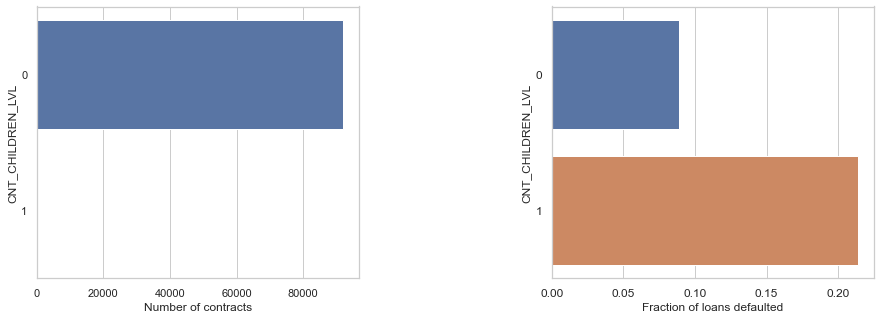

In [120]:
plot_bar_gen('CNT_CHILDREN_LVL', df=application)

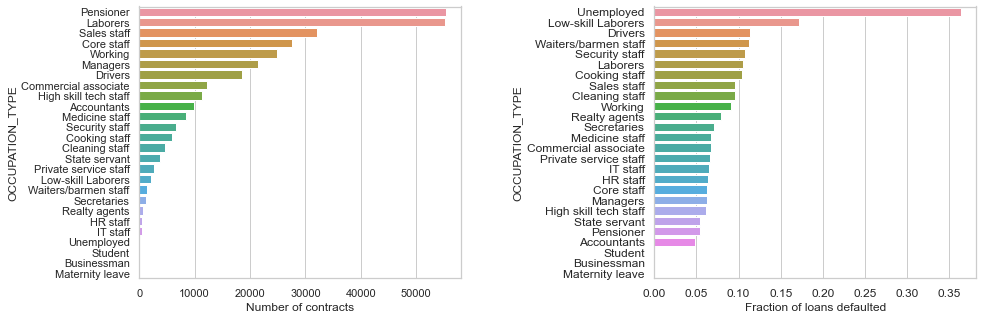

In [121]:
plot_bar_gen('OCCUPATION_TYPE', df=application)

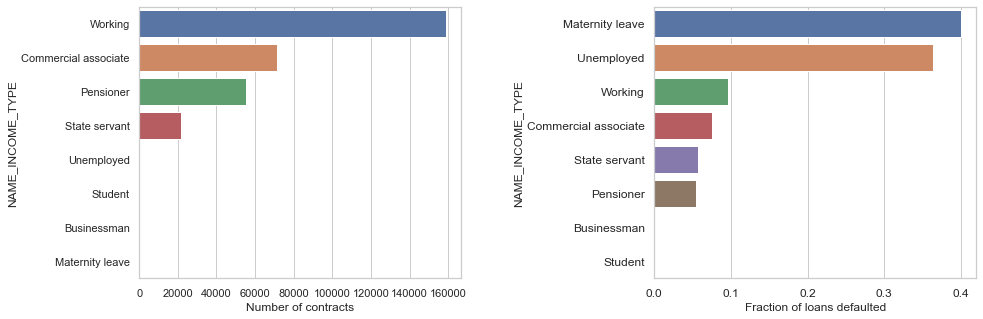

In [122]:
plot_bar_gen('NAME_INCOME_TYPE', df=application)

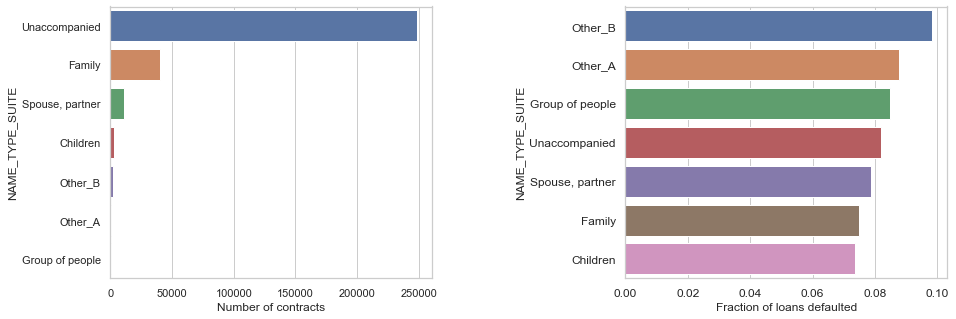

In [123]:
plot_bar_gen('NAME_TYPE_SUITE', df=application)

In [124]:
any_applications.drop(columns='NAME_TYPE_SUITE', inplace=True)

# Missing values

In [125]:
any_applications['AMT_REQ_CREDIT_BUREAU_HOUR'].fillna(0, inplace=True)
any_applications['AMT_REQ_CREDIT_BUREAU_DAY'].fillna(0, inplace=True)
any_applications['AMT_REQ_CREDIT_BUREAU_WEEK'].fillna(0, inplace=True)
any_applications['AMT_REQ_CREDIT_BUREAU_MON'].fillna(0, inplace=True)
any_applications['AMT_REQ_CREDIT_BUREAU_QRT'].fillna(0, inplace=True)
any_applications['AMT_REQ_CREDIT_BUREAU_YEAR'].fillna(0, inplace=True)


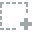
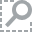
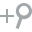
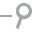
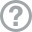
...
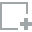
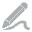
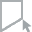
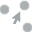
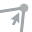

In [128]:
plot_missing(any_applications)

In [132]:
previous.drop(columns='NAME_TYPE_SUITE', inplace=True)

In [133]:
previous.drop(
    columns=['RATE_INTEREST_PRIMARY',
             'RATE_INTEREST_PRIVILEGED',
             'WEEKDAY_APPR_PROCESS_START',
             'HOUR_APPR_PROCESS_START',
             'FLAG_LAST_APPL_PER_CONTRACT',
             'NFLAG_LAST_APPL_IN_DAY'],
    inplace=True)


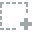
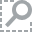
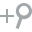
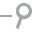
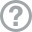
...
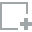
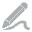
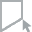
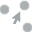
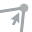

In [134]:
plot_missing(previous)

## Lean datasets

In [135]:
# save the lean datasets
with open("Data/bureau.pkl", mode="wb") as df1:
    pickle.dump(bureau, df1)
with open("Data/previous.pkl", mode="wb") as df2:
    pickle.dump(previous, df2)
with open("Data/any_app.pkl", mode="wb") as df3:
    pickle.dump(any_applications, df3)